<a href="https://colab.research.google.com/github/parkhy0106/HolyMoly/blob/master/Uformer_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Citations
@misc{wang2021uformer,
    title   = {Uformer: A General U-Shaped Transformer for Image Restoration}, 
    author  = {Zhendong Wang and Xiaodong Cun and Jianmin Bao and Jianzhuang Liu},
    year    = {2021},
    eprint  = {2106.03106},
    archivePrefix = {arXiv},
    primaryClass = {cs.CV}
}



#Requirements

In [ ]:
pip install uformer-pytorch

In [ ]:
cd ..

In [ ]:
!pip install dacon_submit_api-0.0.4-py3-none-any.whl

Processing ./dacon_submit_api-0.0.4-py3-none-any.whl
ERROR: Could not install packages due to an OSError: [Errno 2] No such file or directory: '/content/drive/My Drive/photo_rise/submissionsubmission_64/dacon_submit_api-0.0.4-py3-none-any.whl'



In [ ]:
cd ../content/drive/MyDrive/photo_rise/models/Uformer

/content/drive/MyDrive/photo_rise/models/Uformer


In [ ]:
cd /content

/content


In [ ]:
!git clone https://github.com/ZhendongWang6/Uformer.git

Cloning into 'Uformer'...
remote: Enumerating objects: 62, done.
remote: Counting objects: 100% (62/62), done.
remote: Compressing objects: 100% (52/52), done.
remote: Total 62 (delta 19), reused 41 (delta 8), pack-reused 0
Unpacking objects: 100% (62/62), done.


In [ ]:
cd Uformer

/content/Uformer


In [ ]:
!pip3 install -r requirements.txt

     |████████████████████████████████| 776.8 MB 15 kB/s 
     |████████████████████████████████| 12.8 MB 55.9 MB/s 
     |████████████████████████████████| 376 kB 57.0 MB/s 
  Created wheel for ptflops: filename=ptflops-0.6.6-py3-none-any.whl size=8903 sha256=25ba38c3c8c23c645a55bf1dd329edb3fbf977735a0ce4da50851a193d389bef
  Stored in directory: /root/.cache/pip/wheels/eb/7c/e5/2332373fcac1b39ba9eb95698ac370da3e14eaba5516e22721
Successfully built ptflops
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torcht

#Data Loading for task

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchsummary import summary
from uformer_pytorch import Uformer
from glob import glob
from tqdm import tqdm
import numpy as np
import os
from natsort import natsorted
import cv2
from joblib import Parallel, delayed
import multiprocessing
import argparse
from google.colab.patches import cv2_imshow as imshow
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
import math
import zipfile

import pandas as pd

In [ ]:
import utils 

In [ ]:
directory = '/content/drive/MyDrive/photo_rise/'
model_direct = '/content/drive/MyDrive/photo_rise/models'

In [ ]:
train_csv = pd.read_csv(directory + 'train.csv')
test_csv = pd.read_csv(directory + 'test.csv')

In [ ]:
train_all_input_files = directory+'train_input_img/'+train_csv['input_img']
train_all_label_files = directory+'train_label_img/'+train_csv['label_img']

In [ ]:
test_all_files = directory+'test_input_img/'+test_csv['input_img']

In [ ]:
train_input_files = train_all_input_files[60:].to_numpy()
train_label_files = train_all_label_files[60:].to_numpy()
 
val_input_files = train_all_input_files[:60].to_numpy()
val_label_files = train_all_label_files[:60].to_numpy()

In [ ]:
mode = 'cut_right' #if drive responce is not stable use cut_right or direct
if mode == 'cut_right':
  directory = directory = '/content/'
else:
  directory = directory = '/content/drive/MyDrive/photo_rise/'

##Save dataset

In [ ]:
tar = directory + 'datasets/denoising/sidd/train'
PS = 256
NUM_PATCHES = 300
NUM_CORES = 10

noisy_patchDir = os.path.join(tar, 'input')
clean_patchDir = os.path.join(tar, 'groundtruth')

if os.path.exists(tar):
    os.system("rm -r {}".format(tar))

os.makedirs(noisy_patchDir)
os.makedirs(clean_patchDir)


def save_files(i):
    noisy_file, clean_file = train_input_files[i], train_label_files[i]
    noisy_img = cv2.imread(noisy_file)
    clean_img = cv2.imread(clean_file)

    H = noisy_img.shape[0]
    W = noisy_img.shape[1]
    for j in range(NUM_PATCHES):
        rr = np.random.randint(0, H - PS)
        cc = np.random.randint(0, W - PS)
        noisy_patch = noisy_img[rr:rr + PS, cc:cc + PS, :]
        clean_patch = clean_img[rr:rr + PS, cc:cc + PS, :]

        cv2.imwrite(os.path.join(noisy_patchDir, '{}_{}.png'.format(i+1,j+1)), noisy_patch)
        cv2.imwrite(os.path.join(clean_patchDir, '{}_{}.png'.format(i+1,j+1)), clean_patch)

Parallel(n_jobs=NUM_CORES)(delayed(save_files)(i) for i in tqdm(range(len(train_input_files))))

100%|██████████| 562/562 [08:26<00:00,  1.11it/s]


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,

In [ ]:
tar = directory + 'datasets/denoising/sidd/val'
PS = 256
NUM_PATCHES = 300
NUM_CORES = 10

noisy_patchDir = os.path.join(tar, 'input')
clean_patchDir = os.path.join(tar, 'groundtruth')

if os.path.exists(tar):
    os.system("rm -r {}".format(tar))

os.makedirs(noisy_patchDir)
os.makedirs(clean_patchDir)


def save_files(i):
    noisy_file, clean_file = val_input_files[i], val_label_files[i]
    noisy_img = cv2.imread(noisy_file)
    clean_img = cv2.imread(clean_file)

    H = noisy_img.shape[0]
    W = noisy_img.shape[1]
    for j in range(NUM_PATCHES):
        rr = np.random.randint(0, H - PS)
        cc = np.random.randint(0, W - PS)
        noisy_patch = noisy_img[rr:rr + PS, cc:cc + PS, :]
        clean_patch = clean_img[rr:rr + PS, cc:cc + PS, :]

        cv2.imwrite(os.path.join(noisy_patchDir, '{}_{}.png'.format(i+1,j+1)), noisy_patch)
        cv2.imwrite(os.path.join(clean_patchDir, '{}_{}.png'.format(i+1,j+1)), clean_patch)

Parallel(n_jobs=NUM_CORES)(delayed(save_files)(i) for i in tqdm(range(len(val_input_files))))

100%|██████████| 60/60 [00:47<00:00,  1.27it/s]


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [ ]:
cv2.imread(test_all_files[0]).shape[0]/32*cv2.imread(test_all_files[0]).shape[1]/32

7803.0

In [ ]:
!rm -r /content/datasets/denoising/sidd/test/groundtruth/

In [ ]:
from tqdm.auto import tqdm

In [ ]:
def cut_img(img_path_list, save_path, stride):
    os.makedirs(f'{save_path}', exist_ok=True)
    num = 0
    for path in tqdm(img_path_list):
        img = cv2.imread(path)
        a = -1
        for top in range(0, img.shape[0], stride):
            a += 1
            b = -1
            for left in range(0, img.shape[1], stride):
                b += 1
                head_tail = os.path.split(path)
                file_name = head_tail[1].split(sep='.')[0]
                piece = np.zeros([img_size, img_size, 3], np.uint8)
                temp = img[top:top+img_size, left:left+img_size, :]
                piece[:temp.shape[0], :temp.shape[1], :] = temp
                cv2.imwrite(f'{save_path}/{file_name}_{a}_{b}.png', piece)
                num+=1

In [ ]:
img_size = 256

In [ ]:
!rm -rf /content/datasets/denoising/sidd/test

In [ ]:
cut_img(test_all_files, '/content/datasets/denoising/sidd/test/input', 128)

  0%|          | 0/20 [00:00<?, ?it/s]

0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17
6_18
6_19
6_20
6_21
6_22
6_23
6_24
6_25
7_0
7_1
7_2
7_3
7_4
7_5
7_6
7_7
7_8
7_9
7_10
7_11
7_12
7_13
7_14
7_15
7_16
7_17
7_18
7_19
7_20
7_21
7_22
7_23
7_24
7_25
8_0
8_1
8_2
8_3
8_4
8_5
8_6
8_7
8_8
8_9


  5%|▌         | 1/20 [00:01<00:32,  1.70s/it]

17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18

 10%|█         | 2/20 [00:03<00:30,  1.70s/it]

17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_

 15%|█▌        | 3/20 [00:05<00:28,  1.68s/it]

18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11


 20%|██        | 4/20 [00:06<00:27,  1.69s/it]

17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_

 25%|██▌       | 5/20 [00:08<00:27,  1.83s/it]

18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17
6_18
6_19
6_20
6_21
6_22

 30%|███       | 6/20 [00:10<00:24,  1.78s/it]

18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_

 35%|███▌      | 7/20 [00:12<00:22,  1.74s/it]

18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17
6_18
6_19
6_

 40%|████      | 8/20 [00:13<00:20,  1.70s/it]

19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17
6_18
6_19
6_20
6_21
6_22
6_23
6_24
6_25
7_0
7_1
7_2
7_3
7_4
7_5
7_6
7_7
7_8
7_9
7_10
7_11
7_12
7_13
7_14
7_15
7_16
7_17
7_18
7_19
7_20
7_21
7_22
7_23
7_24
7_25
8_0
8_1
8_2
8_3


 45%|████▌     | 9/20 [00:15<00:18,  1.68s/it]

18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17
6_18
6_19
6_20
6_21
6_22

 50%|█████     | 10/20 [00:17<00:16,  1.65s/it]

16_15
16_16
16_17
16_18
16_19
16_20
16_21
16_22
16_23
16_24
16_25
17_0
17_1
17_2
17_3
17_4
17_5
17_6
17_7
17_8
17_9
17_10
17_11
17_12
17_13
17_14
17_15
17_16
17_17
17_18
17_19
17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3


 55%|█████▌    | 11/20 [00:18<00:14,  1.64s/it]

19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17
6_18
6_19
6_20
6_21
6_22
6_23
6_24
6_25
7_0
7_1
7_2
7_3
7_4
7_5
7_6
7_7
7_8
7_9
7_10
7_11
7_12
7_13
7_14

 60%|██████    | 12/20 [00:20<00:14,  1.83s/it]

16_19
16_20
16_21
16_22
16_23
16_24
16_25
17_0
17_1
17_2
17_3
17_4
17_5
17_6
17_7
17_8
17_9
17_10
17_11
17_12
17_13
17_14
17_15
17_16
17_17
17_18
17_19
17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9


 65%|██████▌   | 13/20 [00:22<00:12,  1.77s/it]

19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17
6_18
6_19
6_20
6_21
6_22
6_23
6_24
6_25
7_0
7_1
7_2
7_3
7_4
7_5
7_6
7_7
7_8
7_9
7_10
7_11
7_12
7_13
7_14
7_15
7_16
7_17
7_18
7_19
7_20
7_21
7_22
7_23
7_24
7_25
8_0
8_1
8_2
8_3
8_4
8_5
8_6


 70%|███████   | 14/20 [00:24<00:10,  1.70s/it]

17_7
17_8
17_9
17_10
17_11
17_12
17_13
17_14
17_15
17_16
17_17
17_18
17_19
17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_

 75%|███████▌  | 15/20 [00:25<00:08,  1.66s/it]

16_15
16_16
16_17
16_18
16_19
16_20
16_21
16_22
16_23
16_24
16_25
17_0
17_1
17_2
17_3
17_4
17_5
17_6
17_7
17_8
17_9
17_10
17_11
17_12
17_13
17_14
17_15
17_16
17_17
17_18
17_19
17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3


 80%|████████  | 16/20 [00:27<00:07,  1.77s/it]

18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17


 85%|████████▌ | 17/20 [00:29<00:05,  1.69s/it]

17_11
17_12
17_13
17_14
17_15
17_16
17_17
17_18
17_19
17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_

 90%|█████████ | 18/20 [00:30<00:03,  1.64s/it]

16_21
16_22
16_23
16_24
16_25
17_0
17_1
17_2
17_3
17_4
17_5
17_6
17_7
17_8
17_9
17_10
17_11
17_12
17_13
17_14
17_15
17_16
17_17
17_18
17_19
17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_

 95%|█████████▌| 19/20 [00:32<00:01,  1.64s/it]

18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25
0_0
0_1
0_2
0_3
0_4
0_5
0_6
0_7
0_8
0_9
0_10
0_11
0_12
0_13
0_14
0_15
0_16
0_17
0_18
0_19
0_20
0_21
0_22
0_23
0_24
0_25
1_0
1_1
1_2
1_3
1_4
1_5
1_6
1_7
1_8
1_9
1_10
1_11
1_12
1_13
1_14
1_15
1_16
1_17
1_18
1_19
1_20
1_21
1_22
1_23
1_24
1_25
2_0
2_1
2_2
2_3
2_4
2_5
2_6
2_7
2_8
2_9
2_10
2_11
2_12
2_13
2_14
2_15
2_16
2_17
2_18
2_19
2_20
2_21
2_22
2_23
2_24
2_25
3_0
3_1
3_2
3_3
3_4
3_5
3_6
3_7
3_8
3_9
3_10
3_11
3_12
3_13
3_14
3_15
3_16
3_17
3_18
3_19
3_20
3_21
3_22
3_23
3_24
3_25
4_0
4_1
4_2
4_3
4_4
4_5
4_6
4_7
4_8
4_9
4_10
4_11
4_12
4_13
4_14
4_15
4_16
4_17
4_18
4_19
4_20
4_21
4_22
4_23
4_24
4_25
5_0
5_1
5_2
5_3
5_4
5_5
5_6
5_7
5_8
5_9
5_10
5_11
5_12
5_13
5_14
5_15
5_16
5_17
5_18
5_19
5_20
5_21
5_22
5_23
5_24
5_25
6_0
6_1
6_2
6_3
6_4
6_5
6_6
6_7
6_8
6_9
6_10
6_11
6_12
6_13
6_14
6_15
6_16
6_17
6_18
6_19
6_20
6_21
6_22
6_23


100%|██████████| 20/20 [00:33<00:00,  1.69s/it]

16_21
16_22
16_23
16_24
16_25
17_0
17_1
17_2
17_3
17_4
17_5
17_6
17_7
17_8
17_9
17_10
17_11
17_12
17_13
17_14
17_15
17_16
17_17
17_18
17_19
17_20
17_21
17_22
17_23
17_24
17_25
18_0
18_1
18_2
18_3
18_4
18_5
18_6
18_7
18_8
18_9
18_10
18_11
18_12
18_13
18_14
18_15
18_16
18_17
18_18
18_19
18_20
18_21
18_22
18_23
18_24
18_25
19_0
19_1
19_2
19_3
19_4
19_5
19_6
19_7
19_8
19_9
19_10
19_11
19_12
19_13
19_14
19_15
19_16
19_17
19_18
19_19
19_20
19_21
19_22
19_23
19_24
19_25


In [ ]:
def cut_2n_img(img_path_list, save_path, n_split):
    os.makedirs(f'{save_path}', exist_ok=True)
    num = 0
    for path in tqdm(img_path_list):
        img = cv2.imread(path)
        a = -1
        img_size_t = int(img.shape[0]/n_split) 
        img_size_l = int(img.shape[1]/n_split)
        for top in range(0, img.shape[0], int(img.shape[0]/n_split)):
            a += 1
            b = -1
            for left in range(0, img.shape[1], int(img.shape[1]/n_split)):
                b += 1
                head_tail = os.path.split(path)
                file_name = head_tail[1].split(sep='.')[0]
                piece = np.zeros([img_size_t, img_size_l, 3], np.uint8)
                temp = img[top:top+img_size_t, left:left+img_size_l, :]
                piece[:temp.shape[0], :temp.shape[1], :] = temp
                cv2.imwrite(f'{save_path}/{file_name}_{a}_{b}.png', piece)
                num+=1

In [ ]:
cut_2n_img(test_all_files, '/content/datasets/denoising/sidd/test/input', 8)

100%|██████████| 20/20 [00:11<00:00,  1.80it/s]


In [ ]:
!rm -r /content/datasets/denoising/sidd/test/groundtruth/

In [ ]:
cp -r /content/datasets/denoising/sidd/test/input /content/datasets/denoising/sidd/test/groundtruth/

In [ ]:
'''tar = directory + 'datasets/denoising/sidd/test'
PS = 256
NUM_PATCHES = 300
NUM_CORES = 10

noisy_patchDir = os.path.join(tar, 'input')

if os.path.exists(tar):
    os.system("rm -r {}".format(tar))

os.makedirs(noisy_patchDir)


def save_files(i):
    noisy_file = test_all_files[i]
    noisy_img = cv2.imread(noisy_file)

    H = noisy_img.shape[0]
    W = noisy_img.shape[1]
    for j in range(NUM_PATCHES):
        rr = np.random.randint(0, H - PS)
        cc = np.random.randint(0, W - PS)
        noisy_patch = noisy_img[rr:rr + PS, cc:cc + PS, :]

        cv2.imwrite(os.path.join(noisy_patchDir, '{}_{}.png'.format(i+1,j+1)), noisy_patch)

Parallel(n_jobs=NUM_CORES)(delayed(save_files)(i) for i in tqdm(range(len(test_all_files))))'''

100%|██████████| 20/20 [00:06<00:00,  3.17it/s]


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

0
10


NameError: ignored

In [ ]:
!mkdir -p /content/datasets/denoising/sidd/test

In [ ]:
os.

test_input_20000.png  test_input_20007.png  test_input_20014.png
test_input_20001.png  test_input_20008.png  test_input_20015.png
test_input_20002.png  test_input_20009.png  test_input_20016.png
test_input_20003.png  test_input_20010.png  test_input_20017.png
test_input_20004.png  test_input_20011.png  test_input_20018.png
test_input_20005.png  test_input_20012.png  test_input_20019.png
test_input_20006.png  test_input_20013.png


In [ ]:
!python3 /content/Uformer/train.py --arch Uformer --batch_size 16 --gpu '0' --train_ps 128 --train_dir /content/datasets/denoising/sidd/train --env 32_0705_1 \
    --val_dir /content/datasets/denoising/sidd/val --embed_dim 32 --warmup --pretrain_weights /content/drive/MyDrive/photo_rise/models/Uformer/log/Uformer32_0705_1/models/model_best_210730.pth.pth --warmup_epochs=10 --resume

/content/Uformer
Namespace(arch='Uformer', att_se=False, batch_size=16, checkpoint=50, dataset='SIDD', embed_dim=32, env='32_0705_1', eval_workers=8, global_skip=False, gpu='0', local_skip=False, lr_initial=0.0002, mode='denoising', nepoch=250, norm_layer='nn.LayerNorm', optimizer='adamw', pretrain_weights='/content/drive/MyDrive/photo_rise/models/Uformer/log/Uformer32_0705_1/models/model_best_210730.pth.pth', resume=True, save_dir='/home/ma-user/work/deNoTr/log', save_images=False, token_embed='linear', token_mlp='leff', train_dir='/content/datasets/denoising/sidd/train', train_ps=128, train_workers=16, val_dir='/content/datasets/denoising/sidd/val', vit_depth=12, vit_dim=256, vit_mlp_dim=512, vit_nheads=8, vit_patch_size=16, vit_share=False, warmup=True, warmup_epochs=10, weight_decay=0.02, win_size=8)
Now time is :  2021-08-01T04:35:02.623463
You choose Uformer...
Traceback (most recent call last):
  File "/content/Uformer/train.py", line 86, in <module>
    utils.load_checkpoint(mo

In [ ]:
mkdir /content/datasets/denoising/sidd/test

In [ ]:
cp -r /content/drive/MyDrive/photo_rise/test_input_img /content/datasets/denoising/sidd/test/input

In [ ]:
!ls -r /content/datasets/denoising/sidd/test/input/test_input_img_256/

In [ ]:
cp -r /content/datasets/denoising/sidd/test/input /content/datasets/denoising/sidd/test/groundtruth/

In [ ]:
!rm -r /content/datasets/denoising/sidd/result

In [ ]:
cd ../awef

[Errno 2] No such file or directory: '../awef'
/content/Uformer


In [ ]:
!python3 /content/Uformer/test.py --arch Uformer --batch_size 1 --gpu '0' --result_dir ../datasets/denoising/sidd/result/ --input_dir /content/datasets/denoising/sidd/test --weights /content/drive/MyDrive/photo_rise/models/Uformer/log/Uformer32_0705_1/models/model_best_210729.pth --embed_dim 32 --save_images 

You choose Uformer...
===>Testing using weights:  /content/drive/MyDrive/photo_rise/models/Uformer/log/Uformer32_0705_1/models/model_best_210729.pth
100% 10400/10400 [26:10<00:00,  6.62it/s]
PSNR: 31.008815, SSIM: 0.949181 


In [ ]:
from model import Uformer
model_restoration= Uformer(img_size=128,embed_dim=32,win_size=8,token_embed='linear',token_mlp='leff')
model_restoration = torch.nn.DataParallel(model_restoration)
utils.load_checkpoint(model_restoration,'/content/drive/MyDrive/photo_rise/models/Uformer/log/Uformer32_0705_1/models/model_best.pth')

In [ ]:
a = cv2.imread('/content/datasets/denoising/sidd/val/input/10_1.png')

In [ ]:
def cut_test_img(img_path_list, save_path, stride, img_size):
    os.makedirs(f'{save_path}', exist_ok=True)
    num = 0
    for path in tqdm(img_path_list):
        img = cv2.imread(path)
        for top in range(0, img.shape[0], stride):
            for left in range(0, img.shape[1], stride):
                piece = np.zeros([img_size, img_size, 3], np.uint8)
                temp = img[top:top+img_size, left:left+img_size, :]
                piece[:temp.shape[0], :temp.shape[1], :] = temp
                np.save(f'{save_path}{img_size}/{num}.npy', piece)
                num+=1

In [ ]:
head_tail = os.path.split(test_all_files[0])

In [ ]:
head_tail[1].split(sep='.')[0]

'test_input_20000'

In [ ]:
img.shape[0]

612

In [ ]:
aa = cv2.imread('/content/datasets/denoising/sidd/result/test_input_20000_15_36.png') 

In [ ]:
def patch_test_img(img_paths, result_path_list, n_split):
    results = []
    for img_path in result_path_list:
      img = cv2.imread(img_path)
      head_tail = os.path.split(img_path)

      result_img = np.zeros_like(img)
      voting_mask = np.zeros_like(img)

      position = []
      file_name = head_tail[1].split(sep='.')[0]
      file_list = os.listdir(img_paths)
      
      pred_file_list = [file for file in file_list if file.startswith(f'{file_name}_')]
      
      top = math.ceil(result_img.shape[0]/int(img.shape[0]/n_split))
      left = math.ceil(result_img.shape[1]/int(img.shape[1]/n_split))
      topleft_list = np.empty(shape = (top,left), dtype='object')
      print(topleft_list.shape)

      a = -1
      b = -1

      a = -1
      b = -1

      t = []

      for x in pred_file_list:
        ff = x.split(sep=f'{file_name}_')[1]
        fb = ff.split(sep='.')[0]
        top = int(fb.split(sep = '_')[0])
        left = int(fb.split(sep = '_')[1])
        topleft_list[top][left] = cv2.imread(f'/content/datasets/denoising/sidd/result/{x}')
        

      print(topleft_list)
      for y in range(topleft_list.shape[0]):
        for x in range(topleft_list.shape[1]):
          result_img[int(img.shape[0]/n_split)*x:int(img.shape[0]/n_split)*(x+1),int(img.shape[1]/n_split)*y:int(img.shape[1]/n_split)*(y+1)][:] = topleft_list[x][y]
        
        
      #result_img = result_img/voting_mask
      #result_img = result_img.astype(np.uint8)
      results.append(result_img)
            
    return results

In [ ]:
def join_test_img(img_paths, result_path_list, stride):
    results = []
    
    for img_path in result_path_list:
      img = cv2.imread(img_path)
      img = img.astype(np.float32)/255
      head_tail = os.path.split(img_path)

      result_img = np.zeros_like(img)
      voting_mask = np.zeros_like(img)

      position = []
      file_name = head_tail[1].split(sep='.')[0]
      file_list = os.listdir(img_paths)
      
      pred_file_list = [file for file in file_list if file.startswith(f'{file_name}_')]
      
      topn = math.ceil(result_img.shape[0]/stride)
      leftn = math.ceil(result_img.shape[1]/stride)
      topleft_list = np.empty(shape = (topn,leftn), dtype='object')
      batch_count = 0

      a = -1

      for x in pred_file_list:
        ff = x.split(sep=f'{file_name}_')[1]
        fb = ff.split(sep='.')[0]
        n_top = int(fb.split(sep = '_')[0])
        n_left = int(fb.split(sep = '_')[1])
        topleft_list[n_top][n_left] = cv2.imread(f'/content/datasets/denoising/sidd/result/{x}') 

      for top in tqdm(range(0, img.shape[0], stride)):
          a += 1
          b = -1
          for left in range(0, img.shape[1], stride):
              b += 1
              position.append([top, left])
              pred = topleft_list[a][b].astype(np.float32)
              for num, (t, l) in enumerate(position):
                  piece = pred
                  h, w, c = result_img[t:t+img_size, l:l+img_size, :].shape
                  result_img[t:t+img_size, l:l+img_size, :] += piece[:h, :w]
                  voting_mask[t:t+img_size, l:l+img_size, :] += 1
              position = []
        
      result_img = result_img/voting_mask
      result_img = result_img.astype(np.uint8)
      results.append(result_img)
            
    return results

In [ ]:
topleft_list =  []

In [ ]:
topleft_list = np.empty(shape = (10,10), dtype='object')

In [ ]:
result_path = '/content/datasets/denoising/sidd/result'

In [ ]:
results = patch_test_img(result_path,test_all_files,64)

In [ ]:
results = join_test_img(result_path,test_all_files,128)

  0%|          | 0/20 [00:00<?, ?it/s]


AttributeError: ignored

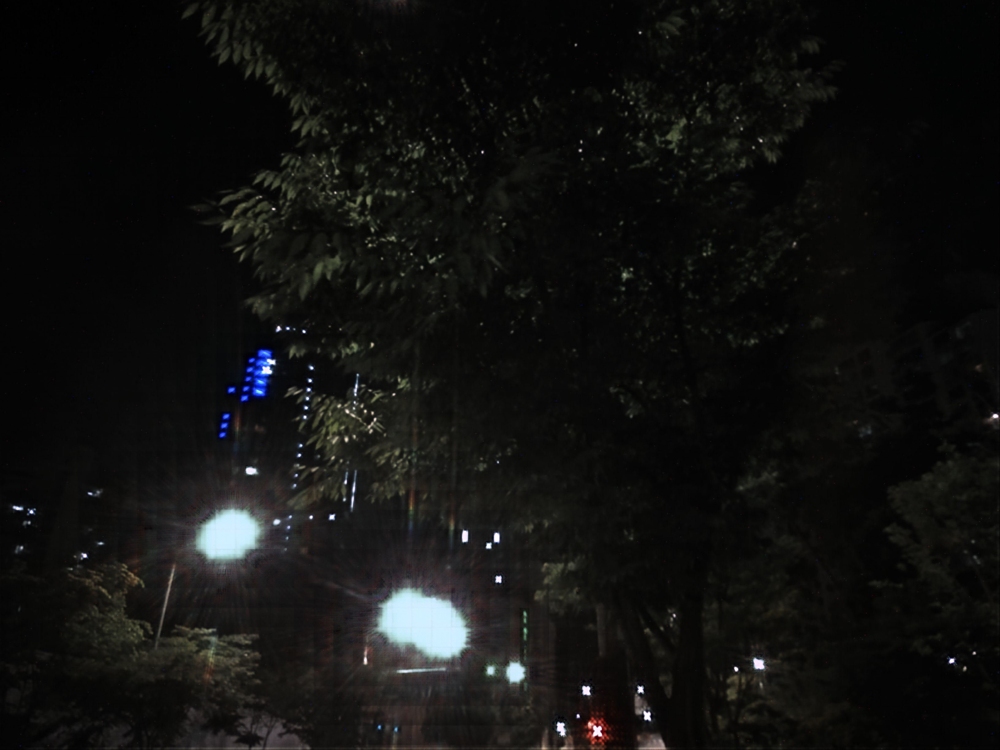

In [ ]:
imshow(results[18])

In [ ]:
def make_submission(result,file_name,directory):
    os.makedirs(directory + 'submission', exist_ok=True)
    os.chdir(directory + 'submission')
    sub_imgs = []
    for i, img in enumerate(result):
        path = f'test_{20000+i}.png'
        cv2.imwrite(path, img)
        sub_imgs.append(path)
    submission = zipfile.ZipFile(file_name+".zip", 'w')
    for path in sub_imgs:
        submission.write(path)
    submission.close()

In [ ]:
directory

'/content/'

In [ ]:
make_submission(results,"submission_uformer_ensemble",'/content/drive/MyDrive/photo_rise/submission')

KeyboardInterrupt: ignored

In [ ]:
1fe18ec00920b674e4ff5ede300d1de21747e98e6ebc2d6689515a675d482443

In [ ]:
from dacon_submit_api import dacon_submit_api 

result = dacon_submit_api.post_submission_file(
'파일경로', 
'1fe18ec00920b674e4ff5ede300d1de21747e98e6ebc2d6689515a675d482443', 
'대회ID', 
'팀이름', 
'제으바알' )

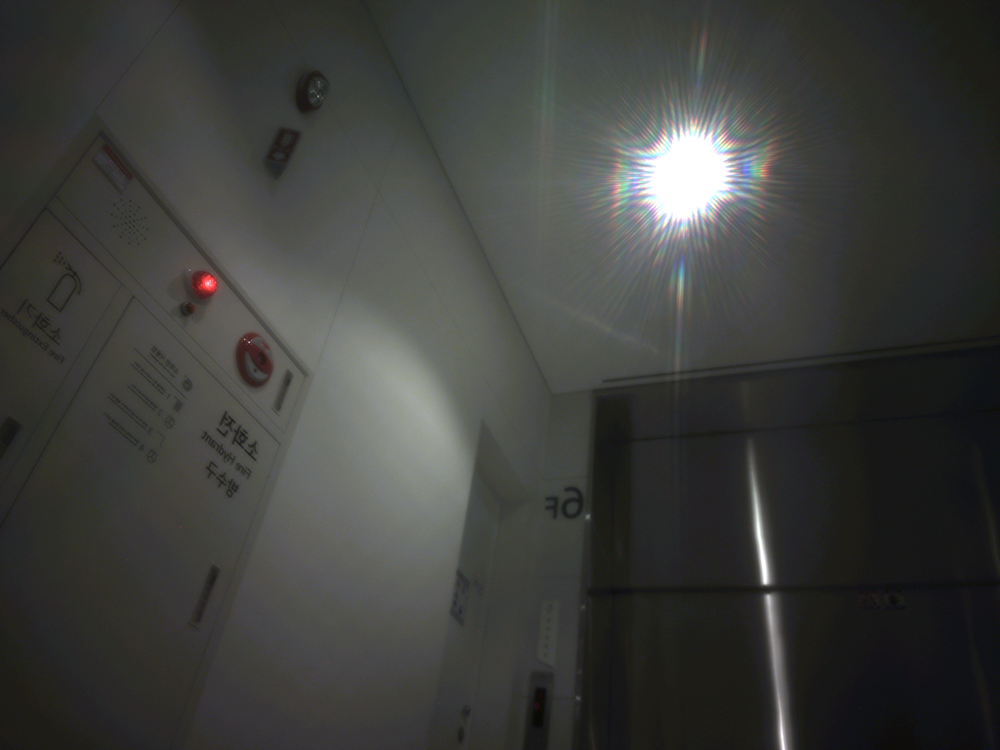

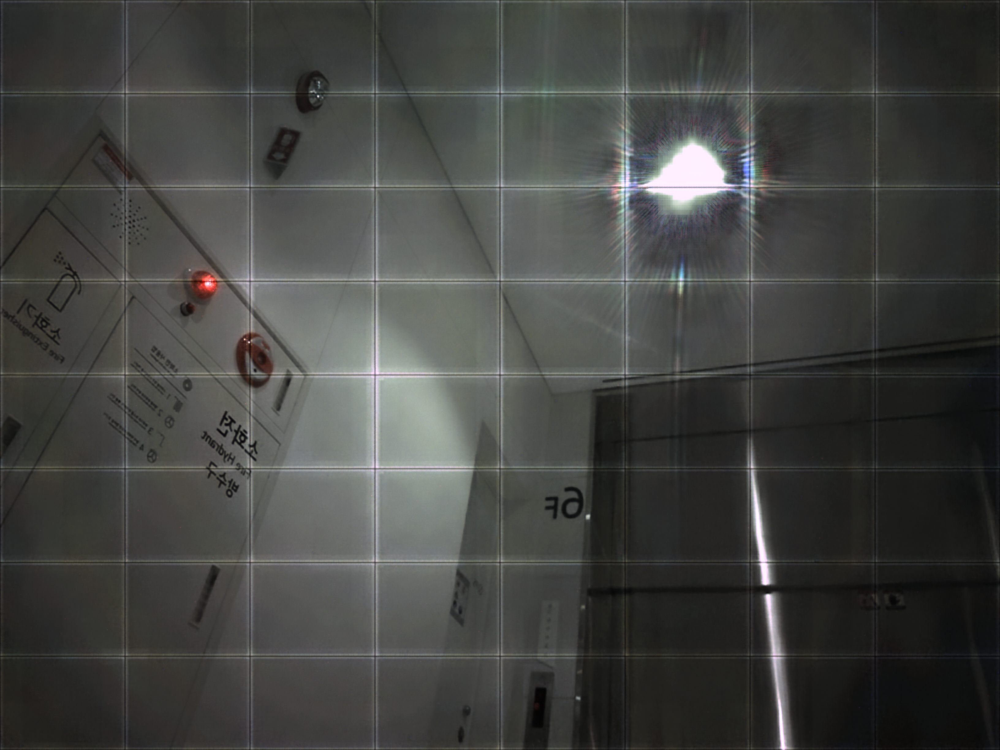

In [ ]:
i = 1
imshow(cv2.imread(test_all_files[i]))
imshow(results[i])

In [ ]:
imshow(b)

In [ ]:
!python3 /content/drive/MyDrive/photo_rise/models/Uformer/test.py --arch Uformer --batch_size 1 --gpu '0' --result_dir ../datasets/denoising/sidd/result/ --input_dir ../datasets/denoising/sidd/test/ --weights /content/drive/MyDrive/photo_rise/models/Uformer/log/Uformer32_0705_1/models/model_best.pth --embed_dim 32 --save_images

Traceback (most recent call last):
  File "/content/drive/MyDrive/photo_rise/models/Uformer/test.py", line 60, in <module>
    test_dataset = get_validation_data(args.input_dir)
  File "/content/drive/MyDrive/photo_rise/models/Uformer/utils/loader.py", line 10, in get_validation_data
    return DataLoaderVal(rgb_dir, None)
  File "/content/drive/MyDrive/photo_rise/models/Uformer/dataset.py", line 133, in __init__
    clean_files = sorted(os.listdir(os.path.join(rgb_dir, gt_dir)))
FileNotFoundError: [Errno 2] No such file or directory: '../datasets/denoising/sidd/test/groundtruth'


In [ ]:
a = cv2.imread('../datasets/denoising/sidd/resut/12_228.png')

In [ ]:
import os

path = ""
file_list = os.listdir(directory + 'datasets/denoising/sidd/test/input')
file_list_py = [file for file in file_list if file.startswith("test_input_20000_")]

print(len(file_list_py))
print(len(file_list))

7855
157086


In [ ]:
imshow(a)

AttributeError: ignored

In [ ]:
!cp -r /content/datasets/denoising/sidd/result /content/drive/MyDrive/photo_rise/datasets/denoising/sidd/results/

In [ ]:
!cp -r /content/datasets/denoising/sidd/result /content/drive/MyDrive/photo_rise/datasets/denoising/sidd/results/

In [ ]:
a = [112]

In [ ]:
data_test[0].numpy().squeeze().transpose((1,2,0))